In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import datetime
from prophet import Prophet
import plotly.graph_objects as go
import plotly.express as px

In [2]:
sales_train_df = pd.read_csv('data/train.csv', low_memory=False)
#sales_train_df.head()
store_info_df = pd.read_csv('data/store.csv')

In [6]:
#Dados das Vendas
#sales_train.isnull().sum()
#sales_train.hist(bins=30, figsize=(20,20), color='r');

In [3]:
closed_train_df = sales_train_df[sales_train_df['Open'] == 0]
open_train_df = sales_train_df[sales_train_df['Open'] == 1]

In [11]:
from dataprep.eda import create_report
report = create_report(open_train_df, title='Meu Relatório')

 67%|###################################3                 | 2/3 [00:00<?, ?it/s]

 67%|###################################3                 | 2/3 [00:00<?, ?it/s]

  0%|                                                  | 0/1413 [00:00<?, ?it/s]

/usr/local/lib/python3.10/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/usr/local/lib/python3.10/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))


Meu Relatório
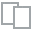
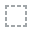
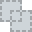
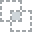
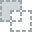
...
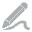
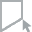
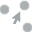
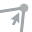
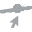

In [13]:
report

In [17]:
from ydata_profiling import ProfileReport

Pandas backend loaded 1.5.1
Numpy backend loaded 1.23.4
Pyspark backend NOT loaded
Python backend loaded


In [28]:
profile = ProfileReport(open_train_df.sample(1000).iloc[:,:5], title="Relatório")


In [39]:
profile

In [30]:
json_data = profile.to_json()

Render JSON:   0%|          | 0/1 [00:00<?, ?it/s]

In [31]:
json_data

'{\n    "analysis": {\n        "title": "Relat\\u00f3rio",\n        "date_start": "2023-05-28 15:07:01.358683",\n        "date_end": "2023-05-28 15:07:08.149306"\n    },\n    "table": {\n        "n": 1000,\n        "n_var": 5,\n        "memory_size": 48000,\n        "record_size": 48.0,\n        "n_cells_missing": 0,\n        "n_vars_with_missing": 0,\n        "n_vars_all_missing": 0,\n        "p_cells_missing": 0.0,\n        "types": {\n            "Numeric": 4,\n            "DateTime": 1\n        },\n        "n_duplicates": 0,\n        "p_duplicates": 0.0\n    },\n    "variables": {\n        "Store": {\n            "n_distinct": 652,\n            "p_distinct": 0.652,\n            "is_unique": false,\n            "n_unique": 399,\n            "p_unique": 0.399,\n            "type": "Numeric",\n            "hashable": true,\n            "value_counts_without_nan": {\n                "511": 5,\n                "97": 5,\n                "1021": 4,\n                "779": 4,\n            

In [32]:
import json
data = json.loads(json_data)

In [37]:

profile.to_file("your_report.json")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
closed_train_df.tail()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
1017204,1111,2,2013-01-01,0,0,0,0,a,1
1017205,1112,2,2013-01-01,0,0,0,0,a,1
1017206,1113,2,2013-01-01,0,0,0,0,a,1
1017207,1114,2,2013-01-01,0,0,0,0,a,1
1017208,1115,2,2013-01-01,0,0,0,0,a,1


In [7]:
sales_train_df = sales_train_df[sales_train_df['Open'] == 1]
sales_train_df.tail()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
1016776,682,2,2013-01-01,3375,566,1,0,a,1
1016827,733,2,2013-01-01,10765,2377,1,0,a,1
1016863,769,2,2013-01-01,5035,1248,1,0,a,1
1017042,948,2,2013-01-01,4491,1039,1,0,a,1
1017190,1097,2,2013-01-01,5961,1405,1,0,a,1


In [6]:
sales_train_df.drop(['Open'], axis=1, inplace=True)

In [7]:
str_cols = ['Promo2SinceWeek', 'Promo2SinceYear', 'PromoInterval', 'CompetitionOpenSinceYear', 'CompetitionOpenSinceMonth']
for str in str_cols:
    store_info_df[str].fillna(0, inplace=True)

In [8]:
store_info_df['CompetitionDistance'].fillna(store_info_df['CompetitionDistance'].mean(), inplace=True)

In [9]:
sales_train_all_df = pd.merge(sales_train_df, store_info_df, how = 'inner', on='Store')

In [10]:
sales_train_all_df.shape

(844392, 17)

In [11]:
sales_train_all_df.head()

,Store,DayOfWeek,Date,Sales,Customers,Promo,StateHoliday,SchoolHoliday,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,5,2015-07-31,5263,555,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
1,1,4,2015-07-30,5020,546,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
2,1,3,2015-07-29,4782,523,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
3,1,2,2015-07-28,5011,560,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
4,1,1,2015-07-27,6102,612,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0


/var/folders/wh/kpgmglvs4l35zzq_d3r6t2bc0000gn/T/ipykernel_78525/937515017.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlations = sales_train_all_df.corr()


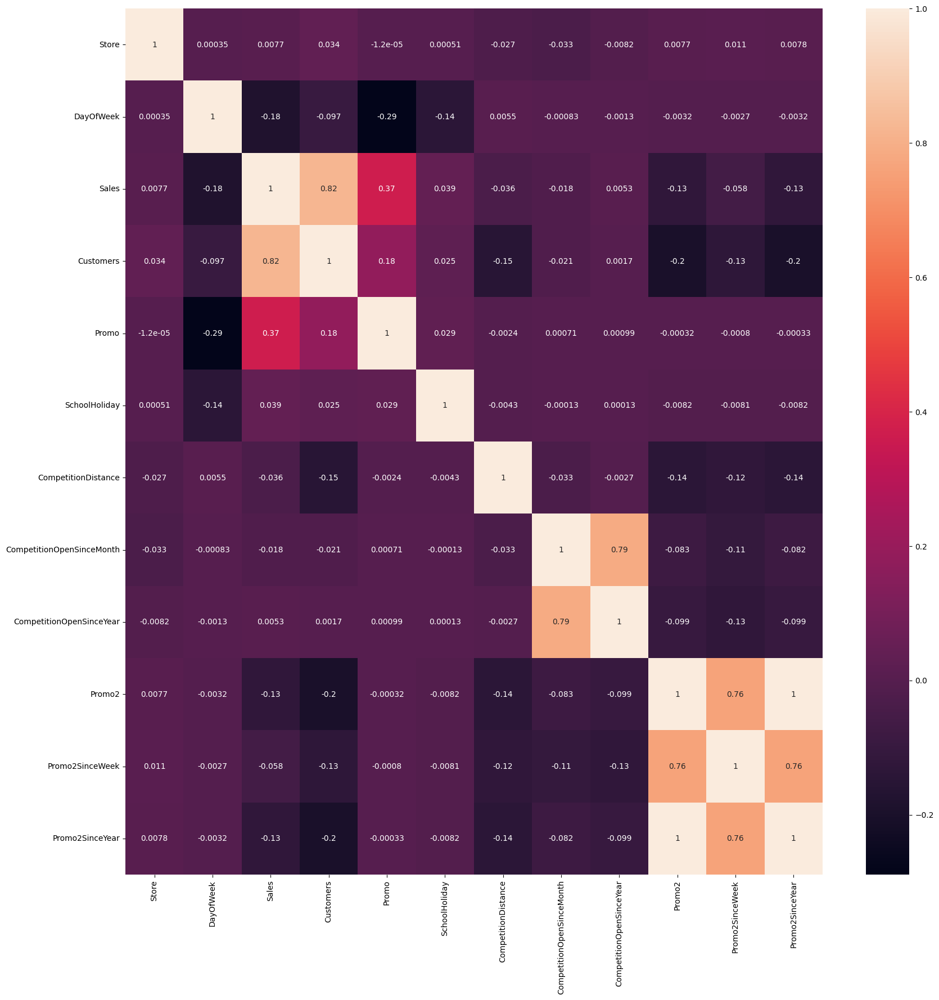

In [31]:
correlations = sales_train_all_df.corr()
f, ax = plt.subplots(figsize=(20,20))
sns.heatmap(correlations, annot=True);

In [33]:
correlations = sales_train_all_df.corr()['Sales'].sort_values()
correlations

/var/folders/wh/kpgmglvs4l35zzq_d3r6t2bc0000gn/T/ipykernel_78525/1950390705.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlations = sales_train_all_df.corr()['Sales'].sort_values()


DayOfWeek                   -0.178736
Promo2SinceYear             -0.127621
Promo2                      -0.127596
Promo2SinceWeek             -0.058476
CompetitionDistance         -0.036343
CompetitionOpenSinceMonth   -0.018370
CompetitionOpenSinceYear     0.005266
Store                        0.007710
SchoolHoliday                0.038617
Promo                        0.368145
Customers                    0.823597
Sales                        1.000000
Name: Sales, dtype: float64

In [12]:
sales_train_all_df['Year'] = pd.DatetimeIndex(sales_train_all_df['Date']).year
sales_train_all_df['Month'] = pd.DatetimeIndex(sales_train_all_df['Date']).month
sales_train_all_df['Day'] = pd.DatetimeIndex(sales_train_all_df['Date']).day


In [13]:
sales_train_all_df.head()

,Store,DayOfWeek,Date,Sales,Customers,Promo,StateHoliday,SchoolHoliday,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,Year,Month,Day
0,1,5,2015-07-31,5263,555,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0,2015,7,31
1,1,4,2015-07-30,5020,546,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0,2015,7,30
2,1,3,2015-07-29,4782,523,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0,2015,7,29
3,1,2,2015-07-28,5011,560,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0,2015,7,28
4,1,1,2015-07-27,6102,612,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0,2015,7,27


Text(0.5, 1.0, 'Média de Vendas por mês')

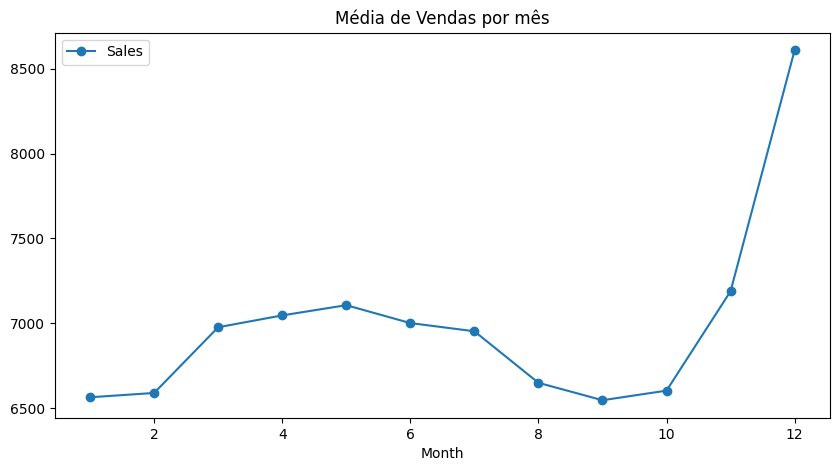

In [42]:
axis = sales_train_all_df.groupby('Month')[['Sales']].mean().plot(figsize=(10,5), marker='o')
axis.set_title('Média de Vendas por mês')

Text(0.5, 1.0, 'Média de Clientes por mês')

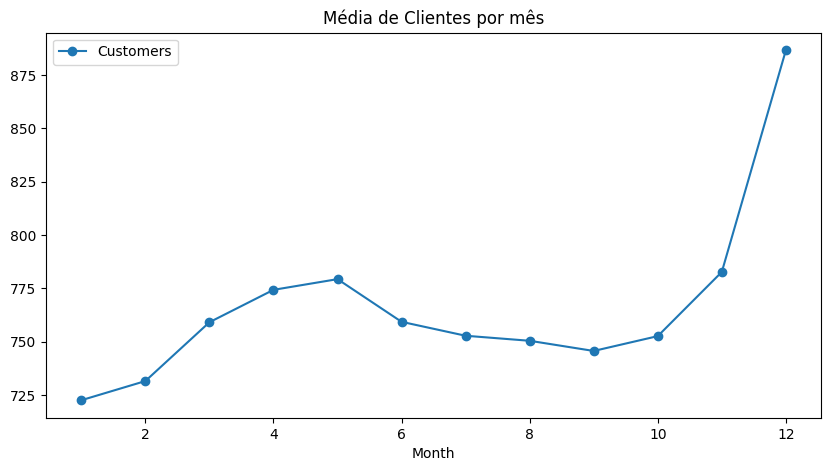

In [44]:
axis = sales_train_all_df.groupby('Month')[['Customers']].mean().plot(figsize=(10,5), marker='o')
axis.set_title('Média de Clientes por mês')

Text(0.5, 1.0, 'Média de Vendas por dia')

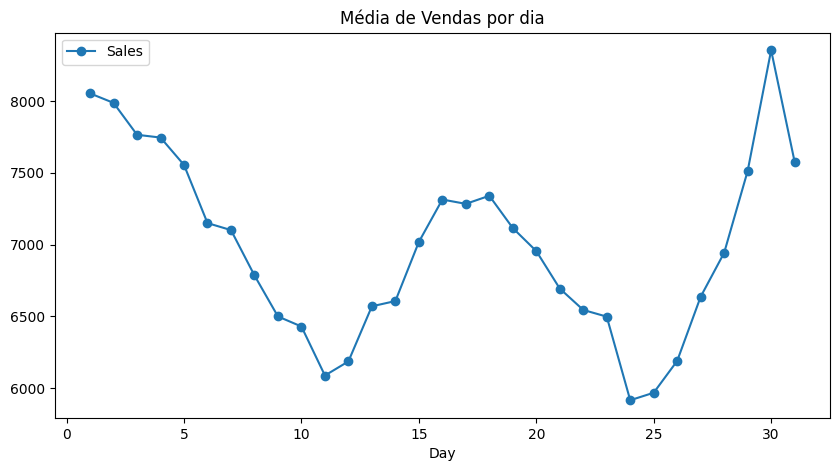

In [45]:
axis = sales_train_all_df.groupby('Day')[['Sales']].mean().plot(figsize=(10,5), marker='o')
axis.set_title('Média de Vendas por dia')

Text(0.5, 1.0, 'Média de Clientes por dia')

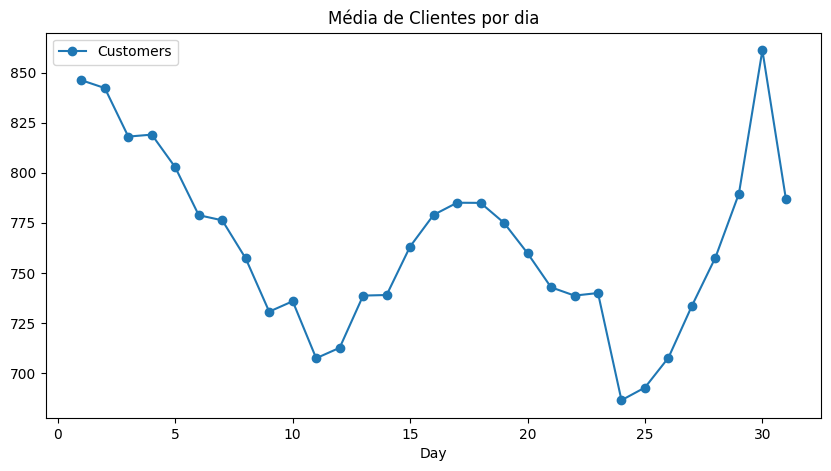

In [46]:
axis = sales_train_all_df.groupby('Day')[['Customers']].mean().plot(figsize=(10,5), marker='o')
axis.set_title('Média de Clientes por dia')

Text(0.5, 1.0, 'Média de Vendas por dia da semana')

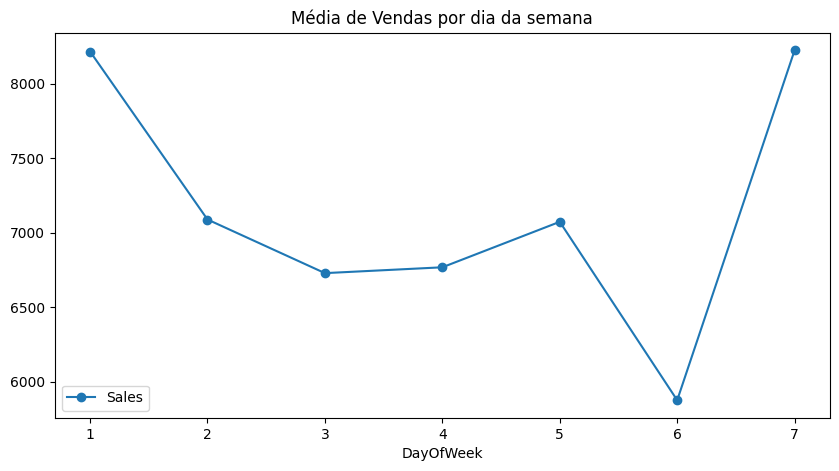

In [48]:
axis = sales_train_all_df.groupby('DayOfWeek')[['Sales']].mean().plot(figsize=(10,5), marker='o')
axis.set_title('Média de Vendas por dia da semana')

Text(0.5, 1.0, 'Média de Clientes por dia da semana')

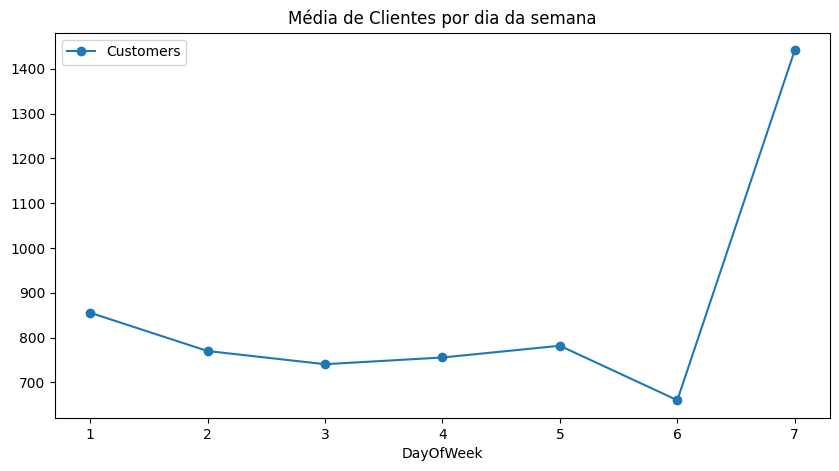

In [49]:
axis = sales_train_all_df.groupby('DayOfWeek')[['Customers']].mean().plot(figsize=(10,5), marker='o')
axis.set_title('Média de Clientes por dia da semana')

/var/folders/wh/kpgmglvs4l35zzq_d3r6t2bc0000gn/T/ipykernel_78525/1967053852.py:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  sales_train_all_df.groupby(['Date','StoreType']).mean()['Sales'].unstack().plot(ax= ax)


<AxesSubplot: xlabel='Date'>

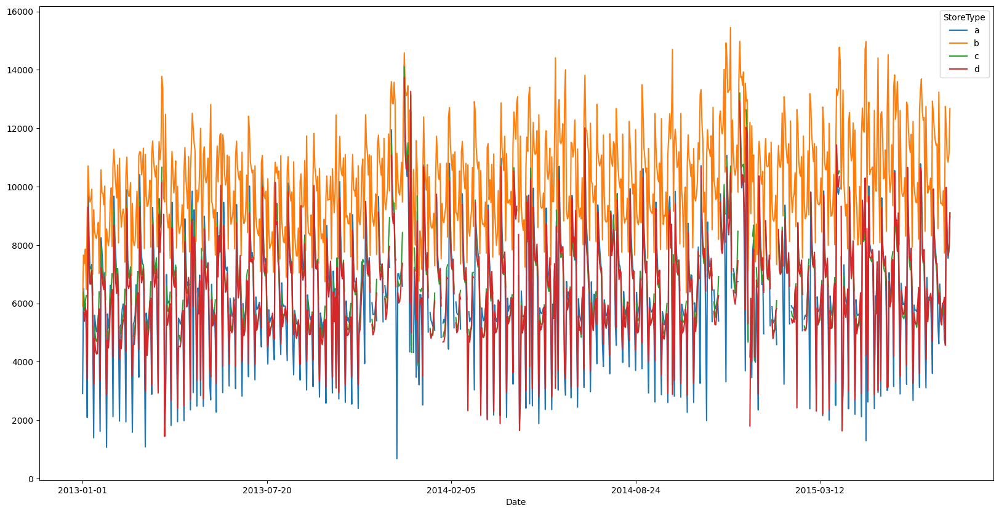

In [52]:
fig, ax = plt.subplots(figsize= (20,10))
sales_train_all_df.groupby(['Date','StoreType']).mean()['Sales'].unstack().plot(ax= ax)

<AxesSubplot: xlabel='Promo', ylabel='Sales'>

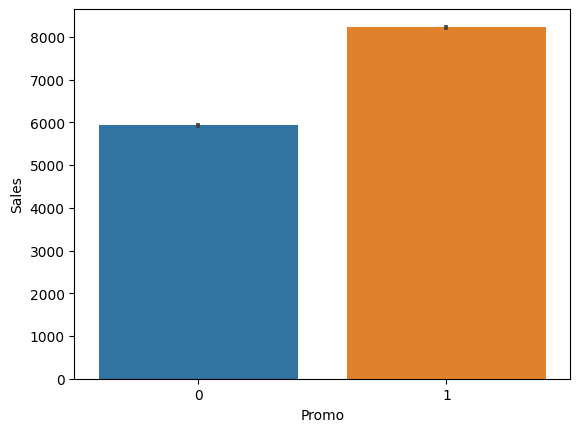

In [56]:
sns.barplot(x = 'Promo', y = 'Sales', data = sales_train_all_df)

<AxesSubplot: xlabel='Promo', ylabel='Customers'>

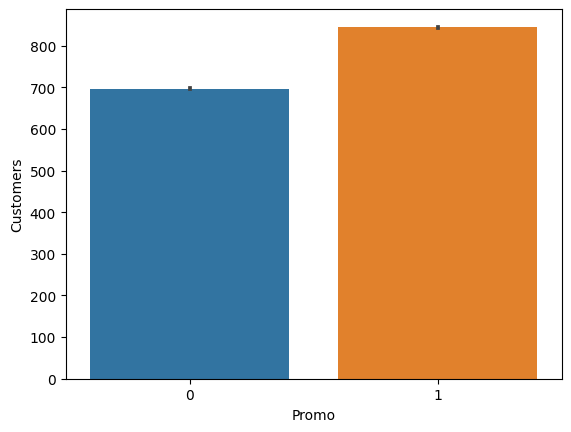

In [57]:
sns.barplot(x = 'Promo', y = 'Customers', data = sales_train_all_df)

In [14]:
def sales_predition(store_id, sales_df, holidays, periods):
    sales_df = sales_df[sales_df['Store'] == store_id]
    sales_df = sales_df[['Date', 'Sales']].rename(columns = {'Date': 'ds', 'Sales':'y'})
    sales_df = sales_df.sort_values(by = 'ds')
    
    model = Prophet(holidays=holidays)
    model.fit(sales_df)
    future = model.make_future_dataframe(periods = periods)
    forecast = model.predict(future)
    figure1 = model.plot(forecast, xlabel= 'Data', ylabel='Vendas')
    figure2 = model.plot_components(forecast)
    
    return sales_df, forecast

In [70]:
#df = sales_predition(10,sales_train_all_df,10)
#df.head()

,ds,y
7819,2013-01-02,4812
7818,2013-01-03,4675
7817,2013-01-04,5114
7816,2013-01-05,4256
7815,2013-01-07,7804


07:52:45 - cmdstanpy - INFO - Chain [1] start processing
07:52:46 - cmdstanpy - INFO - Chain [1] done processing


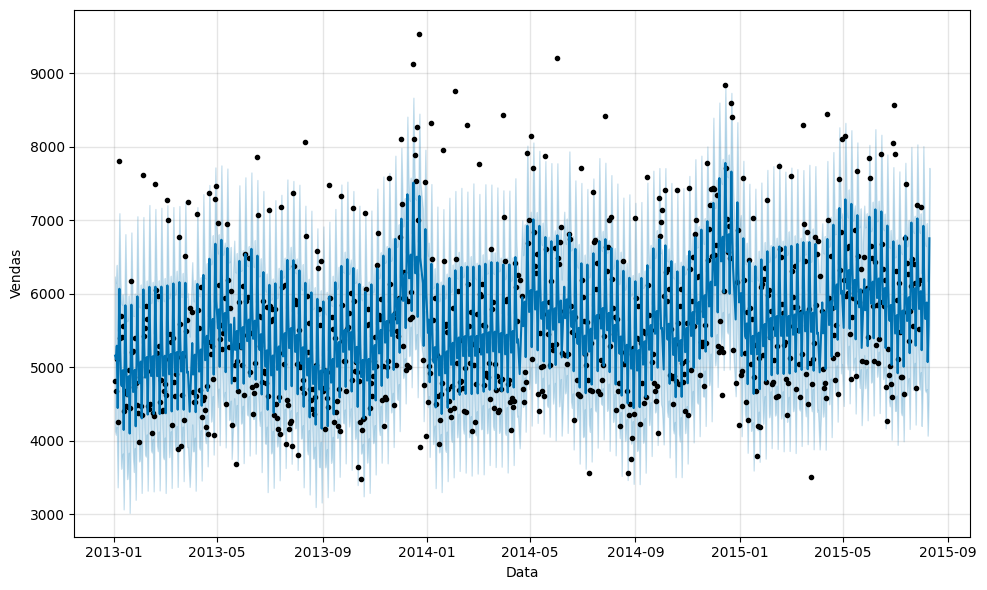

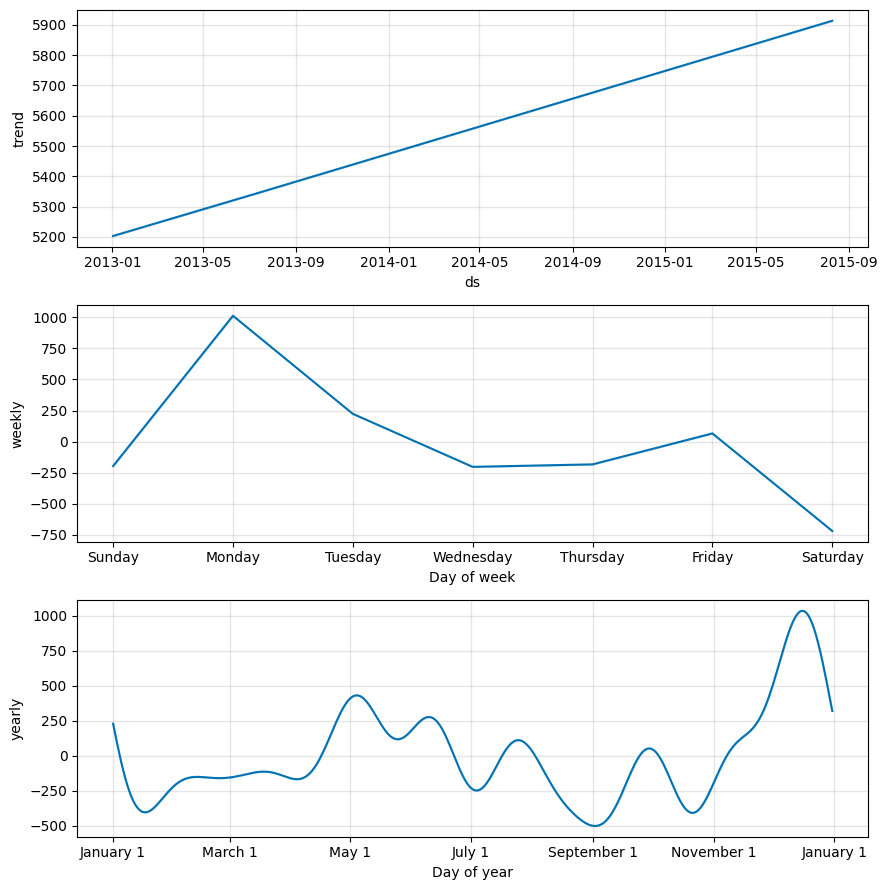

In [72]:
df_origin, df_predition = sales_predition(10, sales_train_all_df, 10)

In [73]:
df_predition.tail(11) # df_predition.tail(11).to_csv('previsoes_vendas.csv')

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
783,2015-07-31,5906.222660,4935.151594,7093.568798,5906.222660,5906.222660,129.632238,129.632238,129.632238,65.860479,65.860479,65.860479,63.771759,63.771759,63.771759,0.0,0.0,0.0,6035.854898
784,2015-08-01,5906.972065,4203.616448,6279.031411,5906.972065,5906.972065,-673.655513,-673.655513,-673.655513,-719.226804,-719.226804,-719.226804,45.571291,45.571291,45.571291,0.0,0.0,0.0,5233.316552
785,2015-08-02,5907.721470,4646.231953,6779.458720,5907.721470,5907.721470,-171.559961,-171.559961,-171.559961,-196.817704,-196.817704,-196.817704,25.257743,25.257743,25.257743,0.0,0.0,0.0,5736.161509
786,2015-08-03,5908.470874,5887.714062,8006.895032,5908.470874,5908.470874,1016.130253,1016.130253,1016.130253,1012.945763,1012.945763,1012.945763,3.184490,3.184490,3.184490,0.0,0.0,0.0,6924.601127
787,2015-08-04,5909.220279,5015.348628,7155.941474,5909.220279,5909.220279,203.313856,203.313856,203.313856,223.602690,223.602690,223.602690,-20.288834,-20.288834,-20.288834,0.0,0.0,0.0,6112.534135
788,2015-08-05,5909.969684,4689.757106,6710.000802,5909.969684,5909.969684,-247.982974,-247.982974,-247.982974,-203.177195,-203.177195,-203.177195,-44.805779,-44.805779,-44.805779,0.0,0.0,0.0,5661.986710
789,2015-08-06,5910.719088,4663.143252,6650.502426,5910.719088,5910.719088,-253.209082,-253.209082,-253.209082,-183.187229,-183.187229,-183.187229,-70.021852,-70.021852,-70.021852,0.0,0.0,0.0,5657.510007
790,2015-08-07,5911.468493,4702.526517,6959.501967,5911.468493,5911.468493,-29.751888,-29.751888,-29.751888,65.860479,65.860479,65.860479,-95.612368,-95.612368,-95.612368,0.0,0.0,0.0,5881.716605
791,2015-08-08,5912.217898,4071.402116,6171.632437,5912.217839,5912.217898,-840.505967,-840.505967,-840.505967,-719.226804,-719.226804,-719.226804,-121.279163,-121.279163,-121.279163,0.0,0.0,0.0,5071.711931
792,2015-08-09,5912.967303,4525.578995,6641.425112,5912.967036,5912.967303,-343.573730,-343.573730,-343.573730,-196.817704,-196.817704,-196.817704,-146.756026,-146.756026,-146.756026,0.0,0.0,0.0,5569.393573


In [15]:
school_holidays = sales_train_all_df[sales_train_all_df['SchoolHoliday'] == 1].loc[:,'Date'].values
school_holidays.shape

(163457,)

In [16]:
#len(np.unique(school_holidays))
state_holidays = sales_train_all_df[(sales_train_all_df['StateHoliday'] == 'a') | 
                                    (sales_train_all_df['StateHoliday'] == 'b') |
                                    (sales_train_all_df['StateHoliday'] == 'c')].loc[:,'Date'].values

In [17]:
state_holidays.shape

(910,)

In [18]:
state_holiday = pd.DataFrame({'ds': pd.to_datetime(state_holidays), 'holiday': 'state_holiday'})

In [19]:
school_holiday = pd.DataFrame({'ds': pd.to_datetime(school_holidays), 'holiday': 'school_holiday'})

In [20]:
school_state_holiday = pd.concat((state_holiday, school_holiday))
school_state_holiday

,ds,holiday
0,2014-10-03,state_holiday
1,2013-10-03,state_holiday
2,2015-06-04,state_holiday
3,2014-06-19,state_holiday
4,2013-05-30,state_holiday
...,...,...
163452,2013-02-05,school_holiday
163453,2013-02-04,school_holiday
163454,2013-01-04,school_holiday
163455,2013-01-03,school_holiday


02:13:40 - cmdstanpy - INFO - Chain [1] start processing
02:13:40 - cmdstanpy - INFO - Chain [1] done processing


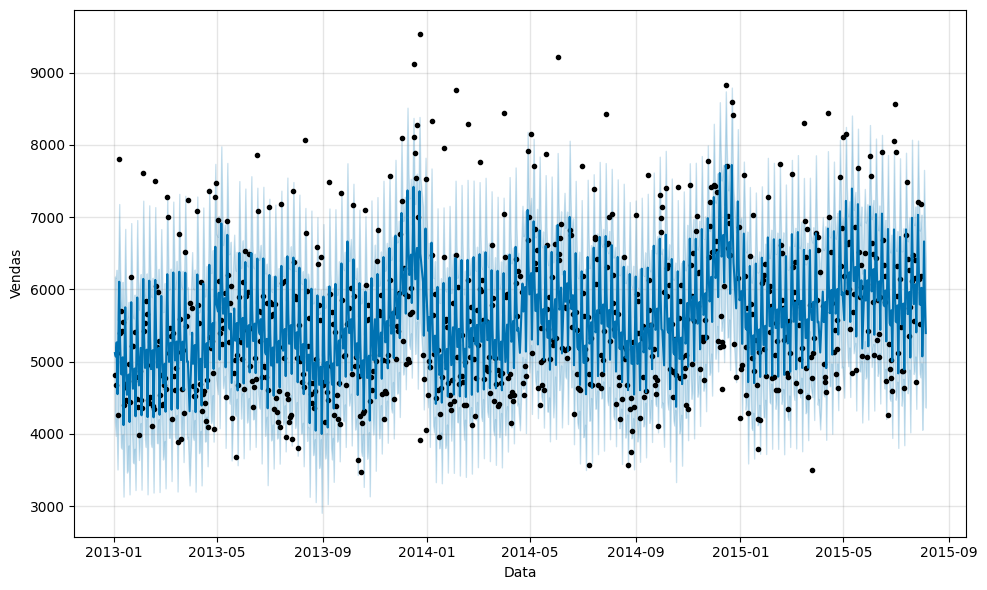

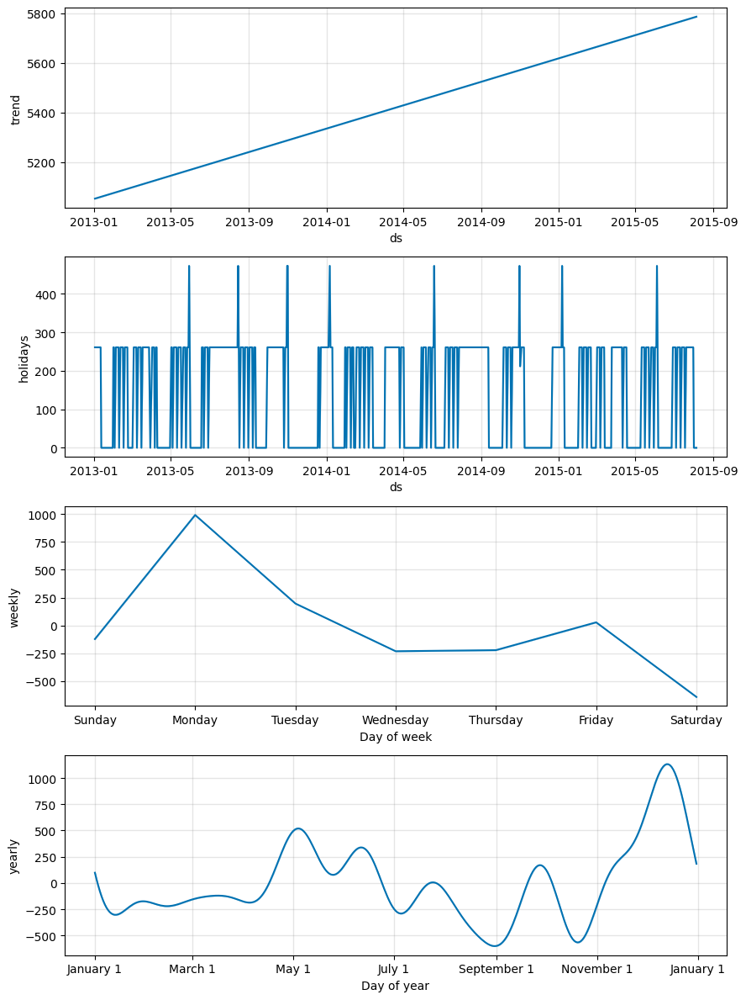

In [21]:
df_original, df_predition = sales_predition(10, sales_train_all_df, school_state_holiday, 5)

In [22]:
df_predition

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,holidays,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2013-01-02,5053.773186,4175.896323,6177.301446,5053.773186,5053.773186,65.388349,65.388349,65.388349,261.221113,...,-231.047290,-231.047290,-231.047290,35.214527,35.214527,35.214527,0.0,0.0,0.0,5119.161535
1,2013-01-03,5054.548871,3975.571893,6159.899499,5054.548871,5054.548871,16.221886,16.221886,16.221886,261.221113,...,-221.456705,-221.456705,-221.456705,-23.542522,-23.542522,-23.542522,0.0,0.0,0.0,5070.770757
2,2013-01-04,5055.324556,4217.937922,6271.224460,5055.324556,5055.324556,212.241499,212.241499,212.241499,261.221113,...,28.077746,28.077746,28.077746,-77.057360,-77.057360,-77.057360,0.0,0.0,0.0,5267.566055
3,2013-01-05,5056.100242,3509.115704,5579.903743,5056.100242,5056.100242,-504.740980,-504.740980,-504.740980,261.221113,...,-640.993265,-640.993265,-640.993265,-124.968828,-124.968828,-124.968828,0.0,0.0,0.0,4551.359262
4,2013-01-07,5057.651612,5010.511004,7181.096331,5057.651612,5057.651612,1048.793955,1048.793955,1048.793955,261.221113,...,990.708745,990.708745,990.708745,-203.135903,-203.135903,-203.135903,0.0,0.0,0.0,6106.445567
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
784,2015-08-01,5783.695342,4058.360376,6129.186634,5783.695342,5783.695342,-710.120450,-710.120450,-710.120450,0.000000,...,-640.993265,-640.993265,-640.993265,-69.127186,-69.127186,-69.127186,0.0,0.0,0.0,5073.574892
785,2015-08-02,5784.471031,4485.746307,6588.871820,5784.471031,5784.471031,-211.827747,-211.827747,-211.827747,0.000000,...,-121.986209,-121.986209,-121.986209,-89.841538,-89.841538,-89.841538,0.0,0.0,0.0,5572.643284
786,2015-08-03,5785.246720,5613.649538,7653.258624,5785.246720,5785.246720,878.674122,878.674122,878.674122,0.000000,...,990.708745,990.708745,990.708745,-112.034623,-112.034623,-112.034623,0.0,0.0,0.0,6663.920842
787,2015-08-04,5786.022408,4837.002210,6892.539835,5786.022408,5786.022408,61.340234,61.340234,61.340234,0.000000,...,196.696978,196.696978,196.696978,-135.356744,-135.356744,-135.356744,0.0,0.0,0.0,5847.362642


In [27]:
fig = px.histogram(df_predition, x="ds", y="holidays", hover_data=df_predition.columns)
fig.show()

# Gráficos para meu dashboard

In [17]:
fig1 = go.Figure()
fig1.add_trace(go.Indicator(
        title = {"text": f"<span style='font-size:150%'>Período de Análise</span><br><span style='font-size:70%'>entre o ano de:</span><br><span>{sales_train_all_df['Year'].min()} - {sales_train_all_df['Year'].max()}</span>"},
        value = (sales_train_all_df['Year'].max() - sales_train_all_df['Year'].min()),
        number = {'suffix': " Anos"}
))

In [18]:
df2_dataframe = sales_train_all_df
df2_dataframe[['Date', 'Sales']].rename(columns = {'Date': 'date', 'Sales':'sales'})


df2 = df2_dataframe.groupby(['Date'])['Sales'].sum().reset_index()
df2.sort_values(ascending=False, inplace=True, by='Sales')

Year = (df2_dataframe['Year'].max()) - (df2_dataframe['Year'].min())

fig2 = go.Figure()
fig2.add_trace(go.Indicator(mode='number+delta',
        title = {"text": f"<span style='font-size:150%'>Maior Rendimento diário em {Year} anos</span><br><span style='font-size:70%'> em relação a média</span><br>"},
        value = df2['Sales'].iloc[0],
        number = {'prefix': "AKZ "},
        delta = {'relative': True, 'valueformat': '.1%', 'reference': df2['Sales'].mean()}
))

In [19]:
df2_dataframe = sales_train_all_df
df2_dataframe[['Date', 'Sales']].rename(columns = {'Date': 'date', 'Sales':'sales'})


df2 = df2_dataframe.groupby(['Date'])['Sales'].sum().reset_index()
df2.sort_values(ascending=False, inplace=True, by='Sales')

Year = (df2_dataframe['Year'].max()) - (df2_dataframe['Year'].min())

fig2 = go.Figure()
fig2.add_trace(go.Indicator(mode='number+delta',
        title = {"text": f"<span style='font-size:150%'>Menor Rendimento diário em {Year} anos</span><br><span style='font-size:70%'> em relação a média</span><br>"},
        value = df2['Sales'].iloc[0],
        number = {'prefix': "AKZ "},
        delta = {'relative': True, 'valueformat': '.1%', 'reference': df2['Sales'].mean()}
))

In [42]:
df3 = sales_train_all_df[sales_train_all_df.columns[1:9]].head(10)


fig3 = go.Figure()
fig3.add_trace(
    go.Table(
        header=dict(
            values=df3.columns,
            font=dict(size=10),
            align="left"
        ),
        cells=dict(
            values=[df3[k].tolist() for k in df3.columns[0:,]],
            align = "left")
    ))

fig3.update_layout(
    showlegend=False,
    title_text="Amostra dos dados a serem analisados",
)


# fig3.add_trace(go.Scatter(
#         x=df3["Date"],
#         y=df3["Sales"],
#         mode="lines",
#         name="hash-rate-TH/s"
#     ))

In [21]:
df4 = sales_train_all_df.groupby('Month')['Sales'].sum().reset_index()

fig = px.pie(df4, values='Sales', names='Month', title='Distribuição das receitas por mês')
fig.show()

In [22]:
df5 = sales_train_all_df.groupby('Day')['Sales'].mean().reset_index()
fig5 = go.Figure()
fig5.add_trace(go.Scatter(
        x=df5["Day"],
        y=df5["Sales"],
        mode="lines",
        name="hash-rate-TH/s"
    ))
fig5.update_layout(
    showlegend=False,
    title_text="Média das vendas por dia",
)

#Dia/DayOfWeek/Mês/Ano

In [23]:
df6 = sales_train_all_df.groupby('Day')['Customers'].mean().reset_index()
fig6 = go.Figure()
fig6.add_trace(go.Scatter(
        x=df6["Day"],
        y=df6["Customers"],
        mode="lines",
        name="hash-rate-TH/s"
    ))
fig6.update_layout(
    showlegend=False,
    title_text="Média de clientes por dia",
)

# fig7 = px.line(df6, x='Day', y='Customers', title='Média de clientes por dia')

# fig7.update_xaxes(
#     rangeslider_visible=True,
#     rangeselector=dict(
#         buttons=list([
#             dict(count=1, label="1m", step="month", stepmode="backward"),
#             dict(count=6, label="6m", step="month", stepmode="backward"),
#             dict(count=1, label="YTD", step="year", stepmode="todate"),
#             dict(count=1, label="1y", step="year", stepmode="backward"),
#             dict(step="all")
#         ])
#     )
# )

#Dia/DayOfWeek/Mês/Ano

In [26]:
d7 = sales_train_all_df[sales_train_all_df['Promo']==1]
fig7 = go.Figure()
fig7.add_trace(go.Indicator(
        title = {"text": f"<span style='font-size:150%'>Promoções realizadas</span><br><span style='font-size:70%'>entre o ano de:</span><br><span>{d7['Year'].min()} - {d7['Year'].max()}</span>"},
        value = (d7['Promo'].count()),
        number = {'suffix': ""}
))

#ANO/MES

In [24]:
d8 = sales_train_all_df[sales_train_all_df['Customers']>0]
fig8 = go.Figure()
fig8.add_trace(go.Indicator(
        title = {"text": f"<span style='font-size:150%'>Clientes Alcançados</span><br><span style='font-size:70%'>entre o ano de:</span><br><span>{d8['Year'].min()} - {d8['Year'].max()}</span>"},
        value = (d8['Customers'].count()),
        number = {'suffix': ""}
))


In [25]:
d9 = sales_train_all_df
fig9 = go.Figure()
fig9.add_trace(go.Indicator(
        title = {"text": f"<span style='font-size:150%'>Receitas Arrecadadas</span><br><span style='font-size:70%'>entre o ano de:</span><br><span>{d9['Year'].min()} - {d9['Year'].max()}</span>"},
        value = (d9['Sales'].sum()),
        number = {'prefix': "AKZ "}
))

In [41]:
sales_train_all_df[sales_train_all_df.columns[1:9]]

,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,5,2015-07-31,5263,555,1,1,0,1
1,4,2015-07-30,5020,546,1,1,0,1
2,3,2015-07-29,4782,523,1,1,0,1
3,2,2015-07-28,5011,560,1,1,0,1
4,1,2015-07-27,6102,612,1,1,0,1
...,...,...,...,...,...,...,...,...
1017204,6,2013-01-05,4771,339,1,0,0,1
1017205,5,2013-01-04,4540,326,1,0,0,1
1017206,4,2013-01-03,4297,300,1,0,0,1
1017207,3,2013-01-02,3697,305,1,0,0,1
